<a href="https://colab.research.google.com/github/TIMEdilation584/JP_Loksatta_moving_hearts/blob/master/with_zip_version_download_ModelBuildingUNETandPSPNet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Semantic Segmentation on Indian Driving Dataset

## 1. Business Problem

### 1.1. Problem Overview

- Most of the datasets for autonomous navigation tend to focus on structured driving environments. This usually corresponds to well-delineated infrastructures such as lanes, a small number of well-deﬁned categories for traﬃc participants, low variation  in an object or background appearance, and strong adherence to traﬃc rules. 
- Indian Driving Dataset (IDD) is a collection of autonomous driving annotated street-level images captured on Indian roads, and formatted to facilitate use for the purpose of training AI systems and neural networks. It consists of images from unstructured environments where the above assumptions are largely not satisfied. It reflects label distributions of road scenes significantly different from existing datasets, with most classes displaying greater within-class diversity. Consistent with real driving behaviors, it also identifies new classes such as drivable areas besides the road.
- It is difficult to completely avoid ambiguity between some labels. For example labels like parking, caravan, or trailer cannot be precisely defined due to the diversity of the scenes and vehicles in the data collected. For resolving this issue, the dataset is designed as a 4 level label hierarchy having 7 (level 1), 16 (level 2), 26 (level 3), and 30 (level 4) labels. 
- The images are obtained from a front-facing camera attached to a car. The car was driven around Hyderabad, Bangalore cities and their outskirts. <br> <br>
Source - http://idd.insaan.iiit.ac.in/


### 1.2 Data 

- There are 1403 train images, 204 validation images and 404 test images
- Shape of the input image and segmentation masks given: [227,320,3]
- Shape of the output segmentation mask expected: [256,128]
<br> <br>
Source - http://idd.insaan.iiit.ac.in/dataset/download/

### 1.3 Challenge

- The idd20k_lite dataset has 7 classes that include Drivable, Non-Drivable, Living things, Vehicles, Road-side objects, Far-objects, and Sky.
- The segmentation challenge is the pixel-level prediction of all the 7 classes at level 1 of the label hierarchy.
- The predictions are supposed to be png images, with the size of 256x128. Each pixel of this image contains the label as level1Ids (see labels code [here](https://github.com/AutoNUE/public-code/blob/312a6ba2219a39fe8b105e44ad0612079249bad8/helpers/anue_labels.py#L40)) of the corresponding image (resized to 256x128). The evaluation code resizes both your prediction and ground truth png files to 256x128, in case they are not of that size.
<br><br> Source - http://idd.insaan.iiit.ac.in/evaluation/ncv19-leader-board/

### 1.4 Performance Metric

- mIoU <br><br>
The performance metric is Mean-Intersection-Over-Union (mIoU). mIoU is a common evaluation metric for semantic image segmentation, which first computes the IOU for each semantic class and then computes the average over classes.


In [1]:
%tensorflow_version 2.x

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
import cv2
from imutils import paths
from tqdm import tqdm
import numpy as np
from glob import glob
import matplotlib.pyplot as plt
%matplotlib inline
import os
import tensorflow as tf
import datetime
from glob import glob
import IPython.display as display
from IPython.display import clear_output
import math
import time
from tensorflow.keras.layers import *
import warnings
warnings.filterwarnings('ignore')
# For more information about autotune:
# https://www.tensorflow.org/guide/data_performance#prefetching
AUTOTUNE = tf.data.experimental.AUTOTUNE
print(f'Tensorflow ver. {tf.__version__}')

Tensorflow ver. 2.5.0


## Loading the Dataset 

In [4]:
# important for reproducibility
# this allows to generate the same random numbers
SEED = 42

# Dataset path
dataset_path = 'drive/My Drive/idd-lite/idd20k_lite/'
img_train = dataset_path + 'leftImg8bit/train/'
seg_train = dataset_path + 'gtFine/train/'

img_val = dataset_path + 'leftImg8bit/val/'
seg_val = dataset_path + 'gtFine/val/'

## Data Visualization 

### Sample Training Image

### Plotting the image 

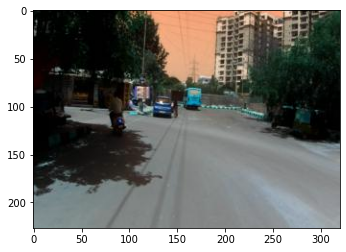

In [5]:
# Reading a sample image and plotting it
img = cv2.imread(img_train+'29/972458_image.jpg',1)  
plt.imshow(img)

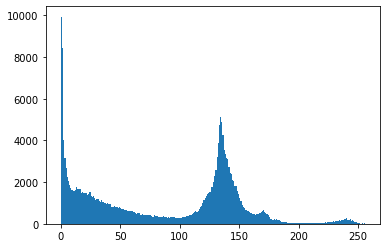

In [6]:
# Plotting an Histogram to find the frequency of pixel intensity values.
plt.hist(img.ravel(),256,[0,256]) 
plt.show()

<b> From the above histogram plot, we get the distribution of the pixel intensity values in the given image. </b>

### Annotated Images

<b> What is Image Annotation? </b>

It is a process of labeling the data (available in the format of images), to make the object in the image recognizable to machines through computer vision technology. Basically, its used to detect, classify and group the objects in machine learning training.

### Plotting the given annotated image 

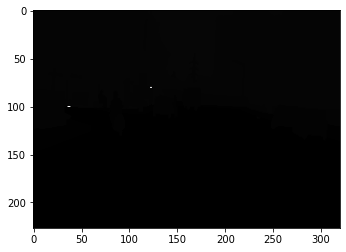

In [7]:
# Reading the given annotated image for the above sample image
img = cv2.imread(seg_train+'29/972458_label.png',1)  
plt.imshow(img)

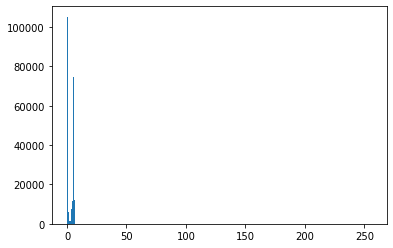

In [8]:
# Plotting an Histogram to find the frequency of pixels intensity values.
plt.hist(img.ravel(),256,[0,256]) 
plt.show()

In [9]:
# Frequency Distribution
# This is to find the exact number of pixels corresponind to each class
y = np.bincount(img.flatten())
ii = np.nonzero(y)[0]
np.vstack((ii, y[ii])).T 

array([[     0, 105186],
       [     1,   5832],
       [     2,   1416],
       [     3,   7371],
       [     4,  11481],
       [     5,  74550],
       [     6,  12069],
       [   255,     15]])

<b> We can observe that, in the annotated image, all of the pixel intensity values are from 0-6 and there are some pixels of the value 255. So, let's get a closer look to the plot in the range 0-6. </b>

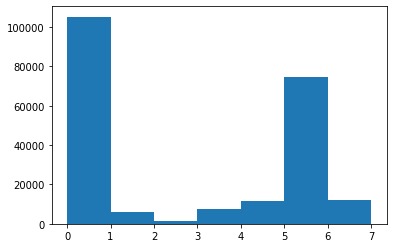

In [10]:
# Plotting an Histogram to find the frequency of pixels intensity values.
plt.hist(img.ravel(),7,[0,7]) 
plt.show()

<b> So, in the given annotated image, all the pixels (excluding the pixel value 255) are from the range 0-6 (for 7 classes). We can intensify these pixels to get clearer annotations, as with a wider range of pixels, it will be easier to distinguish between the pixels as colors vary on a wider range. We will multiply each pixel, excluding 0 and 255 with 40, so we will get different colors with a difference of larger values. </b>

### Plotting the annotated image after intensifying the pixels

In [11]:
# This function visualizes the segmenetation image by multiplying each pixel with 40
# Reference -> https://github.com/saisandeepNSS/IDD_SemanticSegmentation

def visualizeSegmentationImages(imagepath):
    img_seg = cv2.imread(imagepath,0)
    # We are going to loop through all the pixel values and multiply them by 40 now
    for i in range(len(img_seg)):
        for j in range(len(img_seg[0])):
            if img_seg[i][j] != 0 or img_seg[i][j] != 255:
                # max value will be 6*40=240 which is under 255
                img_seg[i][j] *= 40  
    return img_seg

In [12]:
# Getting the processed segmentation image for visualization
img_seg = visualizeSegmentationImages(seg_train+'29/972458_label.png')

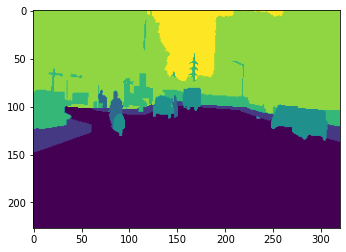

In [13]:
# Plotting the processed segmentation image
plt.imshow(img_seg)

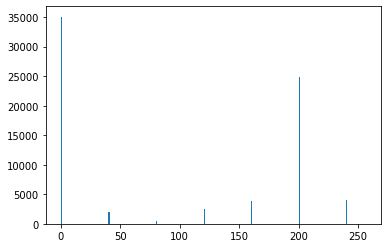

In [14]:
# Plotting an Histogram to find the frequency of pixels intensity values.
plt.hist(img_seg.ravel(),256,[0,256]) 
plt.show()

<b> Now, we can easily distinguish the objects after intensifying the pixels as there are colors vary on a wider range, so it is easy to visualize the annotated image. </b>

## Data Preparation 

<b>References </b> <br>
https://yann-leguilly.gitlab.io/post/2019-12-14-tensorflow-tfdata-segmentation/ <br>
https://www.tensorflow.org/tutorials/load_data/images <br>
https://www.tensorflow.org/tutorials/images/segmentation

In [15]:
# Image size that we are going to use
(HEIGHT,WIDTH) = (128,256)
# Our images are RGB (3 channels)
N_CHANNELS = 3
# Scene Parsing has 7 classes (0-6) + `not labeled`
N_CLASSES = 8

In [16]:
# Reference -> https://docs.python.org/2/library/glob.html
# The glob module finds all the pathnames matching a specified pattern according to 
# the rules used by the Unix shell, although results are returned in arbitrary order. 

TRAINSET_SIZE = len(glob(img_train+'*/*_image.jpg'))
print(f"The Training Dataset contains {TRAINSET_SIZE} images.")

VALSET_SIZE = len(glob(img_val+'*/*_image.jpg'))
print(f"The Validation Dataset contains {VALSET_SIZE} images.")

The Training Dataset contains 1403 images.
The Validation Dataset contains 204 images.


In [17]:
def parse_image(img_path):
    """
    Load an image and its annotation (mask) and returning a dictionary.
    """
    # Reading the image
    image = tf.io.read_file(img_path)
    image = tf.image.decode_jpeg(image, channels=3)
    # For one Image path:
    # .../idd20k_lite/leftImg8bit/train/024541_image.jpg
    # Its corresponding annotation path is:
    # .../idd20k_lite/gtFine/train/024541_label.png
    mask_path = tf.strings.regex_replace(img_path, "leftImg8bit", "gtFine")
    mask_path = tf.strings.regex_replace(mask_path, "_image.jpg", "_label.png")
    # Reading the annotation file corresponding the image file
    mask = tf.io.read_file(mask_path)
    mask = tf.image.decode_png(mask, channels=1)
    # In scene parsing, "not labeled" = 255
    # But it will mess with our N_CLASS = 7
    # Since 255 means the 255th class
    # Which doesn't exist
    mask = tf.where(mask==255, np.dtype('uint8').type(7), mask)
    # Note that we have to convert the new value (7)
    # With the same dtype than the tensor itself
    return {'image': image, 'segmentation_mask': mask}

In [18]:
# Reference -> https://www.tensorflow.org/api_docs/python/tf/data/Dataset#list_files
# tf.data.Dataset.list_files returns a dataset of all files matching one or more glob patterns.

train_dataset = tf.data.Dataset.list_files(img_train+'*/*_image.jpg', seed=SEED)
train_dataset = train_dataset.map(parse_image)

val_dataset = tf.data.Dataset.list_files(img_val+'*/*_image.jpg', seed=SEED)
val_dataset = val_dataset.map(parse_image)

In [19]:
# Reference -> https://www.tensorflow.org/api_docs/python/tf/cast
# Returns a Tensor same shape as given tensor and same type as dtype that is mentioned.

def normalize(input_image, input_mask):
    """
    Rescale the pixel values of the images between 0 and 1 compared to [0,255] originally.
    """
    input_image = tf.cast(input_image, tf.float32) / 255.0
    return input_image, input_mask

In [20]:
# Reference -> https://www.tensorflow.org/api_docs/python/tf/image/resize
# Resize images to the size specified

def load_image_train(datapoint):
    """
    Normalize and resize a train image and its annotation.
    Apply random transformations to an input dictionary containing a train image and its annotation.
    """
    input_image = tf.image.resize(datapoint['image'], (HEIGHT,WIDTH))
    input_mask = tf.image.resize(datapoint['segmentation_mask'], (HEIGHT,WIDTH))
    if tf.random.uniform(()) > 0.5:
        input_image = tf.image.flip_left_right(input_image)
        input_mask = tf.image.flip_left_right(input_mask)
    input_image, input_mask = normalize(input_image, input_mask)
    return input_image, input_mask

def load_image_test(datapoint):
    """
    Normalize and resize a test image and its annotation.
    Since this is for the test set, we don't need to apply any data augmentation technique.
    """
    input_image = tf.image.resize(datapoint['image'], (HEIGHT,WIDTH))
    input_mask = tf.image.resize(datapoint['segmentation_mask'], (HEIGHT,WIDTH))
    input_image, input_mask = normalize(input_image, input_mask)
    return input_image, input_mask

In [21]:
BATCH_SIZE = 32
BUFFER_SIZE = 1500
dataset = {"train": train_dataset, "val": val_dataset}

In [22]:
# Reference -> https://www.tensorflow.org/api_docs/python/tf/data/Dataset

# Preparing the Train dataset by applying dataset transformations
dataset['train'] = dataset['train'].map(load_image_train, num_parallel_calls=tf.data.experimental.AUTOTUNE)
dataset['train'] = dataset['train'].shuffle(buffer_size=BUFFER_SIZE, seed=SEED)
dataset['train'] = dataset['train'].repeat()
dataset['train'] = dataset['train'].batch(BATCH_SIZE)
dataset['train'] = dataset['train'].prefetch(buffer_size=AUTOTUNE)
print(dataset['train'])

# Preparing the Validation Dataset
dataset['val'] = dataset['val'].map(load_image_test)
dataset['val'] = dataset['val'].repeat()
dataset['val'] = dataset['val'].batch(BATCH_SIZE)
dataset['val'] = dataset['val'].prefetch(buffer_size=AUTOTUNE)
print(dataset['val'])

<PrefetchDataset shapes: ((None, 128, 256, 3), (None, 128, 256, 1)), types: (tf.float32, tf.float32)>
<PrefetchDataset shapes: ((None, 128, 256, 3), (None, 128, 256, 1)), types: (tf.float32, tf.float32)>


## Visualizing after processing the data 

In [23]:
def display_sample(display_list):
    """
    Show side-by-side an input image,
    the ground truth and the prediction.
    """
    plt.figure(figsize=(15,15))
    title = ['Input Image', 'True Mask', 'Predicted Mask']
    for i in range(len(display_list)):
        plt.subplot(1, len(display_list), i+1)
        plt.title(title[i])
        plt.imshow(tf.keras.preprocessing.image.array_to_img(display_list[i]))
        plt.axis('off')
    plt.show()

In [26]:
# Getting a sample image for visualizing
for image, mask in dataset['train'].take(1):
    sample_image, sample_mask = image, mask

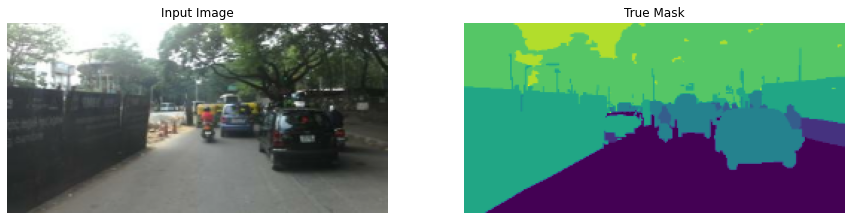

In [27]:
# Displaying a sample Input Image and its corresponding mask
display_sample([sample_image[0], sample_mask[0]])

# Model Building 

## U-net Architecture

The <b>U-net architecture </b> is symmetric and consists of two major parts — <br>
the first part is called contracting path (Encoder), which is constituted by the general convolutional process; <br>
the second part is expansive path (Decoder), which is constituted of Upsampling technique. <br> <br>
<b> Contracting path - Encoder</b> <br>
The contracting path follows the formula: <br>
max_pooling -> Convolution_1 -> Convolution_2 <br>
The process is repeated 5 more times with filter_sizes 64,128,256,512,1024. <br> 
Encoder_64 -> Encoder_128 -> Encoder_256 -> Encoder_512 -> Encoder_1024 -> .. <br> <br>
<b> Expansive Path - Decoder </b> <br>
In the expansive path, the image is going to be upsized to its original size. The formula follows: <br>
UpSampling -> Convolution_1 -> Concatenate -> Convolution_2 -> Convolution_3 <br>
This process is also repeated 4 more times with filter_sizes 512,256,128,64. <br>
.. Decoder_512 -> Decoder_256 -> Deocoder_128 -> Decoder_64 -> Convolution (with filter_size as number of classes)

In [28]:
# This class is for building the Encoder Block
# Each encoder block (except the first block) consists of 3 layers -> 
# Max_Pooling -> Convolution_1 -> Convolution_2 
class EncoderBlock(tf.keras.Model):
  
    def __init__(self, filter_size, block_number, initializer='he_normal'):
        super(EncoderBlock, self).__init__()
        # this variable gives the information about the number of the encoder block
        # this is useful as the first encoder block has a different structure with no max pool layer
        self.block_number = block_number
        # Each encoder block will have different number of filters
        self.filter_size = filter_size
        # defining the max pool layer with size 2
        self.max_pool_layer = MaxPooling2D(pool_size=(2,2))
        # defining the convolution layers
        self.convolution_layer_1 = Convolution2D(self.filter_size, 3, activation = 'relu', padding='same', kernel_initializer=initializer)
        self.convolution_layer_2 = Convolution2D(self.filter_size, 3, activation = 'relu', padding='same', kernel_initializer=initializer)

    def call(self,inputs):
        # as the first block doesn't have max pool layer we have to define its structure only if the block number is 1
        if(self.block_number==1):
            # the inputs will be passed to the first convolution layer
            x = self.convolution_layer_1(inputs)
            # The output of first convolution layer will be passed to second convolution layer
            x = self.convolution_layer_2(x)
            return x
        # After the first block, for all the encoder blocks the output will be passed to a max_pool layer first
        x = self.max_pool_layer(inputs)
        # The Max pool out will be passed to first convolution layer
        x = self.convolution_layer_1(x)
        # The output of first convolution layer will be passed to the second convolution layer 
        x = self.convolution_layer_2(x)
        return x

In [29]:
# This class is for building the Decoder Block
# Each encoder block (except the last block) consists of 4 layers -> 
# UpSampling -> Convolution_1 -> Concatenate -> Convolution_2 -> Convolution_3
class DecoderBlock(tf.keras.Model):
    
    def __init__(self, filter_size, block_number, initializer='he_normal'):
        super(DecoderBlock, self).__init__()
        # Each decoder block has different number of filters
        self.filter_size = filter_size
        # this variable gives the information about the number of the decoder block
        # this is useful as the layer decoder block has a different structure with an extra convolution layer
        self.block_number = block_number
        # defining the UpSampling layer
        self.upsampling_layer = UpSampling2D(size=(2,2))
        # defining the convolution layers
        self.convolution_layer_1 = Convolution2D(self.filter_size, 2, activation = 'relu', padding='same', kernel_initializer=initializer)
        self.convolution_layer_2 = Convolution2D(self.filter_size, 3, activation = 'relu', padding='same', kernel_initializer=initializer)
        self.convolution_layer_3 = Convolution2D(self.filter_size, 3, activation = 'relu', padding='same', kernel_initializer=initializer)
        # defining the convolution layer for last decoder block
        self.convolution_layer_4 = Convolution2D(2, 3, activation = 'relu', padding = 'same', kernel_initializer = initializer)
    
    def call(self,inputs,encoder_layer):
        # The input is first passed to the UpSampling layer and then passed to the convolution layer
        x = self.convolution_layer_1(self.upsampling_layer(inputs))
        # The output of the convolution layer is concatenated with corresponding encoder layer output
        merged = concatenate([encoder_layer,x], axis=3)
        # The merged output is passed to second convolution layer
        x = self.convolution_layer_2(merged)
        # The output of the second convolution layer is passed to the third convolution layer
        x = self.convolution_layer_3(x)
        # For the last decoder block, one more convolution layer is added with filter_size = 2
        if(self.block_number==4):
            x = self.convolution_layer_4(x)
        return x

In [30]:
# This class defines the entire Segmentation Model
# There are 5 Encoder Blocks and 4 Decoder blocks with convolution layer as the last layer
# Encoder_64 -> Encoder_128 -> Encoder_256 -> Encoder_512 -> Encoder_1024 ->
# Decoder_512 -> Decoder_256 -> Deocoder_128 -> Decoder_64 ->
# Convolution_layer (with filter size as number_of_output_channels)
class SegmentationModel(tf.keras.Model):
    
    def __init__(self, output_channels, initializer = 'he_normal', dynamic=True):
        super(SegmentationModel, self).__init__()
        # getting the number of output channels
        self.output_channels = output_channels
        # defining the encoder blocks with filter sizes 64,128,256,512,1024
        self.encoder_block_1 = EncoderBlock(64,1)
        self.encoder_block_2 = EncoderBlock(128,2)
        self.encoder_block_3 = EncoderBlock(256,3)
        self.encoder_block_4 = EncoderBlock(512,4)
        self.encoder_block_5 = EncoderBlock(1024,5)
        # defining the decoder blocks with filter sizes 512,256,128,64
        self.decoder_block_1 = DecoderBlock(512,1)
        self.decoder_block_2 = DecoderBlock(256,2)
        self.decoder_block_3 = DecoderBlock(128,3)
        self.decoder_block_4 = DecoderBlock(64,4)
        # defining the last convolution layer with filter_size as number_of_output_channels
        self.output_layer = Convolution2D(self.output_channels, 1, activation='softmax')
    
    def call(self,inputs):
        # The input is passed to the first encoder block
        conv_enc_1 = self.encoder_block_1(inputs)
        # Output of each encoder block is passed to the next encoder block
        conv_enc_2 = self.encoder_block_2(conv_enc_1)
        conv_enc_3 = self.encoder_block_3(conv_enc_2)
        conv_enc_4 = self.encoder_block_4(conv_enc_3)
        conv_enc_5 = self.encoder_block_5(conv_enc_4)
        # Output of the previous layer along with the outputs of encoder blocks 
        # in reverse orders are passed to decoder layers
        conv_dec_1 = self.decoder_block_1(conv_enc_5,conv_enc_4)
        conv_dec_2 = self.decoder_block_2(conv_dec_1,conv_enc_3)
        conv_dec_3 = self.decoder_block_3(conv_dec_2,conv_enc_2)
        conv_dec_4 = self.decoder_block_4(conv_dec_3,conv_enc_1)
        # Output of the last Decoder layer is passed to the Convolution layer
        output = self.output_layer(conv_dec_4)
        return output

In [31]:
# SegmentationModel object
model = SegmentationModel(N_CLASSES)

In [32]:
# Defining a loss object and an optimizer
loss_object = tf.keras.losses.SparseCategoricalCrossentropy()
optimizer = tf.keras.optimizers.Adam()
ckpt = tf.train.Checkpoint(step=tf.Variable(1), optimizer=optimizer, net=model)
manager = tf.train.CheckpointManager(ckpt, 'tf_ckpts/', max_to_keep=3)

In [33]:
# Define the metrics
train_loss = tf.keras.metrics.Mean('train_loss', dtype=tf.float32)
train_accuracy = tf.keras.metrics.SparseCategoricalAccuracy('train_accuracy')
test_loss = tf.keras.metrics.Mean('test_loss', dtype=tf.float32)
test_accuracy = tf.keras.metrics.SparseCategoricalAccuracy('test_accuracy')

In [34]:
# Reference -> https://github.com/junhoning/machine_learning_tutorial/blob/b20b8a10438ec3e62f08f920744cc8ea854cde91/Visualization%20%26%20TensorBoard/%5BTensorBoard%5D%20Semantic%20Segmentation.ipynb

@tf.function
def train_step(model, optimizer, x_train, y_train):
    with tf.GradientTape() as tape:
        predictions = model(x_train, training=True)
        loss = loss_object(y_train, predictions)
    grads = tape.gradient(loss, model.trainable_variables)
    optimizer.apply_gradients(zip(grads, model.trainable_variables))
    train_loss(loss)
    train_accuracy(y_train, predictions)
    
def train_and_checkpoint(model, manager, dataset, epoch):
    ckpt.restore(manager.latest_checkpoint)
    if manager.latest_checkpoint:
        print("Restored from {}".format(manager.latest_checkpoint))
    else:
        print("Initializing from scratch.")
    for (x_train, y_train) in dataset['train'].take(math.ceil(1403/32)):
        train_step(model, optimizer, x_train, y_train)
    ckpt.step.assign_add(1)
    save_path = manager.save()
    print("Saved checkpoint for epoch {}: {}".format(epoch, save_path))
    
@tf.function
def test_step(model, x_test, y_test):
    predictions = model(x_test)
    loss = loss_object(y_test, predictions)
    test_loss(loss)
    test_accuracy(y_test, predictions)
    return predictions

In [35]:
# Summary writers for Tensorboard visualization
train_log_dir = 'logs/gradient_tape/train'
test_log_dir = 'logs/gradient_tape/test'
train_summary_writer = tf.summary.create_file_writer(train_log_dir)
test_summary_writer = tf.summary.create_file_writer(test_log_dir)

In [36]:
# This variable will help to save the best model if its performance increases after an epoch   
highest_accuracy = 0

for epoch in range(50):

    print("Epoch ",epoch+1)
    
    # Getting the current time before starting the training
    # This will help to keep track of how much time an epoch took
    start = time.time()
    
    train_and_checkpoint(model, manager, dataset, epoch+1)
    
    # Saving the train loss and train accuracy metric for TensorBoard visualization
    with train_summary_writer.as_default():
        tf.summary.scalar('loss', train_loss.result(), step=ckpt.step.numpy())
        tf.summary.scalar('accuracy', train_accuracy.result(), step=ckpt.step.numpy())
    
    # Validation phase
    for (x_test, y_test) in dataset['val'].take(math.ceil(204/32)):
        pred = test_step(model, x_test, y_test)
    
    # Saving the validation loss and validation accuracy metric for Tensorboard visualization
    with test_summary_writer.as_default():
        tf.summary.scalar('loss', test_loss.result(), step=ckpt.step.numpy())
        tf.summary.scalar('accuracy', test_accuracy.result(), step=ckpt.step.numpy())
    
    # Calculating the time it took for the entire epoch to run
    print("Time taken ",time.time()-start)
    
    # Printing the metrics for the epoch
    template = 'Epoch {}, Loss: {:.3f}, Accuracy: {:.3f}, Val Loss: {:.3f}, Val Accuracy: {:.3f}'
    print (template.format(epoch+1,
                            train_loss.result(), 
                            train_accuracy.result()*100,
                            test_loss.result(), 
                            test_accuracy.result()*100))
    
    # If accuracy has increased in this epoch, updating the highest accuracy and saving the model
    if(test_accuracy.result().numpy()*100>highest_accuracy):
        print("Validation accuracy increased from {:.3f} to {:.3f}. Saving model weights.".format(highest_accuracy,test_accuracy.result().numpy()*100))
        highest_accuracy = test_accuracy.result().numpy()*100
        model.save_weights('unet_weights-epoch-{}.hdf5'.format(epoch+1))

    print('_'*80)

    # Reset metrics after every epoch
    train_loss.reset_states()
    test_loss.reset_states()
    train_accuracy.reset_states()
    test_accuracy.reset_states()

Epoch  1
Initializing from scratch.
Saved checkpoint for epoch 1: tf_ckpts/ckpt-1
Time taken  105.84397339820862
Epoch 1, Loss: 2.067, Accuracy: 26.954, Val Loss: 2.048, Val Accuracy: 22.117
Validation accuracy increased from 0.000 to 22.117. Saving model weights.
________________________________________________________________________________
Epoch  2
Restored from tf_ckpts/ckpt-1
Saved checkpoint for epoch 2: tf_ckpts/ckpt-2
Time taken  25.582484245300293
Epoch 2, Loss: 2.032, Accuracy: 27.293, Val Loss: 2.020, Val Accuracy: 31.420
Validation accuracy increased from 22.117 to 31.420. Saving model weights.
________________________________________________________________________________
Epoch  3
Restored from tf_ckpts/ckpt-2
Saved checkpoint for epoch 3: tf_ckpts/ckpt-3
Time taken  25.530513286590576
Epoch 3, Loss: 2.003, Accuracy: 31.784, Val Loss: 1.993, Val Accuracy: 31.254
________________________________________________________________________________
Epoch  4
Restored from tf_ckp

In [37]:
%load_ext tensorboard

In [38]:
%tensorboard --logdir logs/

<IPython.core.display.Javascript object>

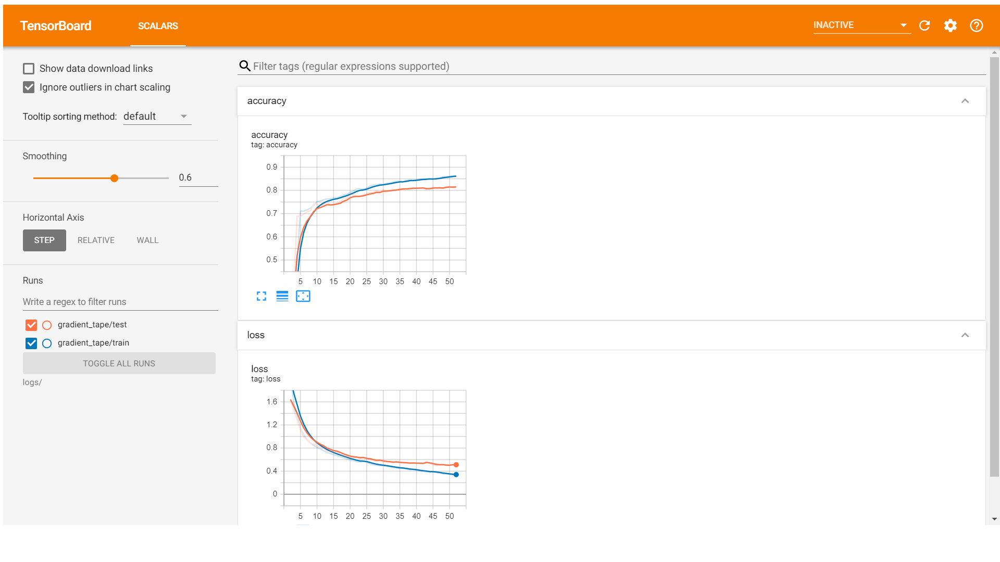

In [ ]:
from IPython.core.display import Image, display
display(Image('unet_scalar_50.png'))

In [40]:
# Loading the weights of the best model
model.load_weights('unet_weights-epoch-24.hdf5')

In [41]:
def predict(model,image_path):
    """
    This function will take the model which is going to be used to predict the image and the image path of 
    the input image as inputs and predict the mask
    It returns the true mask and predicted mask
    """
    # Getting the datapoint
    # This function will load the image and its annotation (mask) and return a dictionary.
    datapoint = parse_image(image_path)
    # Normalizing the resizing the datapoint
    input_image,image_mask = load_image_test(datapoint)
    # As the model takes input with 4 dimensions (batch_size, rows, columns, channels),
    # and the shape of the input image is (rows, columns, channels)
    # we will expand the first dimension so we will get the shape as  (1, rows, columns, channels)
    img = tf.expand_dims(input_image, 0)
    # Predicting the image by passing it to the model
    prediction = model(img)
    # The model will predict 8 outputs for each pixel
    # We have to get the maximum value out of it
    prediction = tf.argmax(prediction, axis=-1)
    prediction = tf.squeeze(prediction, axis = 0)
    pred_mask = tf.expand_dims(prediction, axis=-1)
    # Displaying the input image, true mask, predicted mask
    # Uncomment this when you want to display the results
    #display_sample([input_image, image_mask, pred_mask])
    return image_mask, pred_mask

In [43]:
# Calling the predict function
true_mask, pred_mask = predict(model,'drive/My Drive/idd-lite/idd20k_lite//leftImg8bit/val/21/240284_image.jpg')

In [44]:
# Reference -> https://github.com/saisandeepNSS/IDD_SemanticSegmentation

def IoU(y_i,y_pred):
    # This function calculates the mean Intersection over Union
    # Mean IoU = TP/(FN + TP + FP)
    # This list will save the IoU of all the classes
    IoUs = []
    # Defining the number of classes which the model has predicted
    n_classes = 8
    for c in range(n_classes):
        # Calculating the True Positives
        TP = np.sum((y_i == c)&(y_pred==c))
        # Calculating the False Positives
        FP = np.sum((y_i != c)&(y_pred==c))
        # Calculating the False Negatives
        FN = np.sum((y_i == c)&(y_pred!= c))
        # Calculating the IoU for the particular class
        IoU = TP/float(TP + FP + FN)
        # Printing the outputs
        # Uncomment the print statement below when you want to analyze the results for each class
        # print("class {:02.0f}: #TP={:6.0f}, #FP={:6.0f}, #FN={:5.0f}, IoU={:4.3f}".format(c,TP,FP,FN,IoU))
        # Appending the IoU to the list as it mean needs to be calculated later
        if(math.isnan(IoU)):
            IoUs.append(0)
            continue
        IoUs.append(IoU)
    # Calculating the mean
    mIoU = np.mean(IoUs)
    #print("_________________")
    # Uncomment this when you want to print the mean IoU
    #print("Mean IoU: {:4.3f}".format(mIoU))
    return mIoU

In [45]:
IoU(true_mask, pred_mask)

0.03558349609375

In [46]:
# Training for 50 more epochs

for epoch in range(50):

    print("Epoch ",epoch+1)
    
    # Getting the current time before starting the training
    # This will help to keep track of how much time an epoch took
    start = time.time()
    
    train_and_checkpoint(model, manager, dataset, epoch+1)
    
    # Saving the train loss and train accuracy metric for TensorBoard visualization
    with train_summary_writer.as_default():
        tf.summary.scalar('loss', train_loss.result(), step=ckpt.step.numpy())
        tf.summary.scalar('accuracy', train_accuracy.result(), step=ckpt.step.numpy())
    
    # Validation phase
    for (x_test, y_test) in dataset['val'].take(math.ceil(204/32)):
        pred = test_step(model, x_test, y_test)
    
    # Saving the validation loss and validation accuracy metric for Tensorboard visualization
    with test_summary_writer.as_default():
        tf.summary.scalar('loss', test_loss.result(), step=ckpt.step.numpy())
        tf.summary.scalar('accuracy', test_accuracy.result(), step=ckpt.step.numpy())
    
    # Calculating the time it took for the entire epoch to run
    print("Time taken ",time.time()-start)
    
    # Printing the metrics for the epoch
    template = 'Epoch {}, Loss: {:.3f}, Accuracy: {:.3f}, Val Loss: {:.3f}, Val Accuracy: {:.3f}'
    print (template.format(epoch+1,
                            train_loss.result(), 
                            train_accuracy.result()*100,
                            test_loss.result(), 
                            test_accuracy.result()*100))
    
    # If accuracy has increased in this epoch, updating the highest accuracy and saving the model
    if(test_accuracy.result().numpy()*100>highest_accuracy):
        print("Validation accuracy increased from {:.3f} to {:.3f}. Saving model weights.".format(highest_accuracy,test_accuracy.result().numpy()*100))
        highest_accuracy = test_accuracy.result().numpy()*100
        model.save_weights('unet_weights-epoch-{}.hdf5'.format(epoch+1))

    print('_'*80)

    # Reset metrics after every epoch
    train_loss.reset_states()
    test_loss.reset_states()
    train_accuracy.reset_states()
    test_accuracy.reset_states()

Epoch  1
Restored from tf_ckpts/ckpt-50
Saved checkpoint for epoch 1: tf_ckpts/ckpt-51
Time taken  25.57503366470337
Epoch 1, Loss: 1.659, Accuracy: 31.770, Val Loss: 1.690, Val Accuracy: 31.131
________________________________________________________________________________
Epoch  2
Restored from tf_ckpts/ckpt-51
Saved checkpoint for epoch 2: tf_ckpts/ckpt-52
Time taken  25.604728937149048
Epoch 2, Loss: 1.658, Accuracy: 31.794, Val Loss: 1.684, Val Accuracy: 31.444
________________________________________________________________________________
Epoch  3
Restored from tf_ckpts/ckpt-52
Saved checkpoint for epoch 3: tf_ckpts/ckpt-53
Time taken  25.52877378463745
Epoch 3, Loss: 1.657, Accuracy: 31.791, Val Loss: 1.686, Val Accuracy: 31.136
________________________________________________________________________________
Epoch  4
Restored from tf_ckpts/ckpt-53
Saved checkpoint for epoch 4: tf_ckpts/ckpt-54
Time taken  25.530511617660522
Epoch 4, Loss: 1.656, Accuracy: 31.793, Val Loss: 1.6

In [ ]:
%tensorboard --logdir logs/

In [50]:
display(Image('unet_scalar_100.png'))

NameError: ignored

In [51]:
# Printing the highest accuracy we have got from UNet model
highest_accuracy

31.56719207763672

In [54]:
# Loading the weights of the best model
model.load_weights('unet_weights-epoch-30.hdf5')

In [56]:
# Calling the predict function
true_mask, pred_mask = predict(model,'drive/My Drive/idd-lite/idd20k_lite/leftImg8bit/val/21/240284_image.jpg')

In [57]:
# Getting the mIoU value for sample image
IoU(true_mask, pred_mask)

0.03558349609375

## Observations

<b> After training for 50 more epoch, the mIoU for the sample Image has been increased from <i>0.449</i> to <i>0.506</i> </b>

## Validation Results

### Getting the mIoU for all the validation images

In [58]:
# Getting the paths of all validation images
img_val = dataset_path + 'leftImg8bit/val/'
val_paths = glob(img_val+'*/*_image.jpg')

In [59]:
# Getting the mIoU for all the validation image predictions and storing it in a list
mIoU = []
for path in val_paths:
    true_mask, pred_mask = predict(model,path)
    mIoU.append(IoU(true_mask, pred_mask))

In [60]:
# Getting the average mIoU for all the validation images
print("Validation mIoU = ",sum(mIoU)/len(mIoU))

Validation mIoU =  0.0389709846646178


## Observations

<b> The average mIoU of all the validation images is <i>0.4456</i> </b>

# Prediction of Test Images for UNet model

In [61]:
# Getting the paths of all test images
img_test = dataset_path + 'leftImg8bit/test/'
test_paths = glob(img_test+'*/*_image.jpg')

In [62]:
# Reference -> https://github.com/mohanrajmit/IDD/blob/master/seg_updated.ipynb
test_images_final = []
test_images_name = []

for imagePath in test_paths:
    # Reading the image from the image_path
    image = cv2.imread(imagePath)
    # Suppose the imagePath is = ../idd20k_lite/leftImg8bit/test/8/561264_image.jpg
    # We need the '561264_image.jpg' part
    # So, we split the imagePath on '/' and get the last element
    # So, make = 561264_image.jpg
    make = imagePath.split("/")[-1]
    # We need the filename now
    # filename = 561264 i.e. all the characters before '_'
    filename = make[:make.rfind("_")]
    # Now, we need the directory name in which we have to store the predicted image
    # i.e. the second last element of '../idd20k_lite/leftImg8bit/test/8/561264_image.jpg'
    # after splitting it on the basis of '/'
    # So make_new = 8
    make_new = imagePath.split("/")[-2]  
    # We will define the directory as "output/8"
    directory="output/"+ make_new
    # If the directory does not exist, we will make the directory
    if not os.path.exists(directory):
        os.makedirs(directory)
    # Output image will be stored in the path 'output/8/561264_label.png' 
    # with '_label' attached to the filename
    image_name = "output/"+ make_new+"/"+filename+"_label.png"
    # Storing the image array in test_images_final
    test_images_final.append(image)
    # Storing the image_name in test_images_name
    test_images_name.append(image_name)

In [63]:
test_images_final = np.array(test_images_final)

In [64]:
# Printing the shape of test_images
test_images_final.shape

(404, 227, 320, 3)

In [65]:
for i,image in enumerate(test_images_final):
    # scaling the values to [0,1]
    image = tf.image.convert_image_dtype(image, tf.uint8)
    # resizing the image to (128,256)
    image = tf.image.resize(image, (HEIGHT,WIDTH))
    # As the model takes input with 4 dimensions (batch_size, rows, columns, channels),
    # and the shape of the input image is (rows, columns, channels)
    # we will expand the first dimension so we will get the shape as  (1, rows, columns, channels)
    image = tf.expand_dims(image, 0)
    # Predicting the image
    prediction = model(image)
    # The model will predict 8 outputs for each pixel
    # We have to get the maximum value out of it
    prediction = tf.argmax(prediction, axis=-1)
    # Squeeze removes dimensions of size 1 from the shape of a tensor.
    prediction = tf.squeeze(prediction, axis = 0)
    prediction = tf.expand_dims(prediction, axis=-1)
    # Converting the prediction to an array
    prediction = np.array(prediction)
    # All the pixels that are predicted as 7 belong to the class 255
    prediction[prediction == 7] = 255
    # Stroing the image in the disk using the corresponing image_path and 
    # name stored in test_images_name list
    cv2.imwrite(test_images_name[i],prediction)

In [66]:
# Zipping the output folder
!zip -r output.zip output

  adding: output/ (stored 0%)
  adding: output/552/ (stored 0%)
  adding: output/552/frame0659_label.png (deflated 71%)
  adding: output/343/ (stored 0%)
  adding: output/343/frame33417_label.png (deflated 71%)
  adding: output/343/frame13535_label.png (deflated 71%)
  adding: output/343/frame11408_label.png (deflated 71%)
  adding: output/343/frame32299_label.png (deflated 71%)
  adding: output/343/frame32680_label.png (deflated 71%)
  adding: output/343/frame27880_label.png (deflated 71%)
  adding: output/343/frame15226_label.png (deflated 71%)
  adding: output/343/frame3585_label.png (deflated 71%)
  adding: output/343/frame16617_label.png (deflated 71%)
  adding: output/343/frame17871_label.png (deflated 71%)
  adding: output/343/frame27117_label.png (deflated 71%)
  adding: output/343/frame1419_label.png (deflated 71%)
  adding: output/343/frame35080_label.png (deflated 71%)
  adding: output/572/ (stored 0%)
  adding: output/572/frame87358_label.png (deflated 71%)
  adding: output

## PSPNet

The <b>PSPNet architechture</b> takes into account the global context of the image to predict the local level predictions hence gives better performance on benchmark datasets like PASCAL VOC 2012 and cityscapes. <br><br>
To build this model, we are going to use the same Encoder-Decoder Approach that we used in UNet. <br><br>
<b> Encoding Process (Feature Extraction Phase) </b> <br>
For EncoderBlock, we need two helper classes -> ConvolutionBlock & BasicConvolutionBlock for feature extraction. <br>
ResNet is used for extracting features. <br>
The BasicConvolution Block formula - <br>
convolution_layer -> batch_normalization -> activation. <br>
The Convolution Block contains 3 BasicConvolution Blocks. The filters will be a list with 3 filter sizes (eg. [32,32,64]) where each filter size will be passed to a BasicConvolutionBlock. <br>
The Encoder contains 3 Convolution Blocks where each Convolution block is passed one sublist from the list [[32,32,64],[64,64,128],[128,128,256]]. <br>
<br>
<b> Decoding Process (PyramidPoolingModule) </b> <br>
For DecoderBlock, we need two helper classes -> PyramidFeatureMap and PyramidPoolingModule which is an effective global contextual prior.<br>
Sub-region average pooling is performed for each feature map in PyramidPoolingModule.<br>
The Pyramid Feature Maps follow the formuala - <br>
Pooling -> Convolution -> UpSampling <br>
The PyramidPoolingModule has 4 PyramidFeatureMaps (red, yellow, blue and green). <br>
The Decoder follows the following formula - <br>
Pyramid Pooling Module -> Convolution (with filter_size as number of classes) -> Batch Normalization -> Softmax activation

In [ ]:
# A class to get the basic convolution block 
# convolution_layer -> batch_normalization -> activation
class BasicConvolutionBlock(tf.keras.Model):
    
    def __init__(self, filter_size, kernel_size, dilation_rate, alpha, block_number, initializer='he_normal'):
        super(BasicConvolutionBlock, self).__init__()
        # block_number variable is used to keep a track of blocks as the structure changes slightly for 3rd and 4th block
        self.block_number = block_number
        # defining a convolution layer
        self.convolution_layer = Convolution2D(filter_size, kernel_size =  kernel_size, 
                                               dilation_rate = dilation_rate, padding = 'same',
                                               kernel_initializer = initializer)
        # defining a batch normalization layer
        self.batch_normalization = BatchNormalization()
        # defining a LeakyReLU activation layer
        self.activation = LeakyReLU(alpha = alpha)
        
    def call(self, inputs):
        # getting the convolution output
        conv_output = self.convolution_layer(inputs)
        # normalizaing the convolution output
        norm_output = self.batch_normalization(conv_output)
        # for 3rd block and 4th block, we return the normalized output without activation layer
        if(self.block_number >= 3):
            return norm_output
        # Passing the normalized output through LeakyReLU
        activation_output = self.activation(norm_output)  
        return activation_output

In [ ]:
# A Building Block of Residual Network
class ConvolutionBlock(tf.keras.Model):
    
    def __init__(self, filters, initializer='he_normal'):     
        super(ConvolutionBlock, self).__init__()
        # The filters will be a list with 3 filter sizes (eg. [32,32,64]) where each filter size 
        # will be passed to a BasicConvolutionBlock
        self.filters = filters
        # Defining basic convolution blocks for each filter size
        self.basic_convolution_1 = BasicConvolutionBlock(self.filters[0], (1,1), (1,1), 0.2, 1)
        self.basic_convolution_2 = BasicConvolutionBlock(self.filters[1], (3,3), (2,2), 0.2, 2)
        self.basic_convolution_3 = BasicConvolutionBlock(self.filters[2], (1,1), (1,1), None, 3)
        # Defining the skip connection that is used in Residual BLocks
        self.skip_convolution = BasicConvolutionBlock(self.filters[2], (3,3), (1,1), None, 4)
        # Last Block
        self.add_layer = Add()
        self.relu_activation = ReLU()
     
    def call(self, inputs):
        # Getting the skip input
        skip_input = inputs
        # Getting the convolution outputs from BasicConvolutionBlocks
        output_conv_1 = self.basic_convolution_1(inputs)
        output_conv_2 = self.basic_convolution_2(output_conv_1)
        output_conv_3 = self.basic_convolution_3(output_conv_2)
        output_skip_conv = self.skip_convolution(skip_input)
        # Last Block
        # Adding the skip connection output and output of last convolution block
        add_output = self.add_layer([output_conv_3,output_skip_conv])
        # Passing the added output through ReLU activation
        output = self.relu_activation(add_output)
        return output

In [ ]:
# Encoder block for PSPNet
class EncoderBlock(tf.keras.Model):
    
    def __init__(self, filters):
        super(EncoderBlock, self).__init__()
        # filters -> [[32,32,64],[64,64,128],[128,128,256]]
        # Each sublist in the abover filters list will be passed to ConvolutionBlocks
        # and every single element in the sublist will be further passed to BasicConvolutionBlock
        self.filters = filters
        # Defining the convolution blocks
        self.convolution_block_1 = ConvolutionBlock(self.filters[0])
        self.convolution_block_2 = ConvolutionBlock(self.filters[1])
        self.convolution_block_3 = ConvolutionBlock(self.filters[2])
        
    def call(self, inputs):     
        # Passing the inputs to the Convolution Block defined above
        output_block_1 = self.convolution_block_1(inputs)
        # Passing the output of convolution blocks to futher convolution blocks
        output_block_2 = self.convolution_block_2(output_block_1)
        output_block_3 = self.convolution_block_3(output_block_2) 
        return output_block_3       

In [ ]:
# This class returns the pyramid feature map for Pyramid Pooling module
# Pooling -> Convolution -> UpSampling
class PyramidFeatureMap(tf.keras.Model): 
    
    def __init__(self, block, filter_size, unsampling_size, pool_size, interpolation='bilinear'):
        super(PyramidFeatureMap, self).__init__()
        # There are 4 blocks -> red, yellow, blue, green
        # As the pooling technique is different for Red block, defining a block will help
        # to keep a track of the changes that are required for different blocks
        self.block = block
        # Defining the convolution layer
        self.convolution_layer = Convolution2D(filter_size, kernel_size = (1,1))
        # Defining the UpSampling layer
        self.upsampling_layer = UpSampling2D(unsampling_size, interpolation = interpolation)
        # Defining the average pooling layer that is going to be used for yellow, blue and green
        self.average_pooling = AveragePooling2D(pool_size)
        # Defining a global average pooling layer for red block
        self.global_average_pooling = GlobalAveragePooling2D()
        
    def call(self,inputs):
        # For Red block, we will pass the input through GlobalAveragePooling layer
        if(self.block=='red'):
            pool_output = self.global_average_pooling(inputs)
            pool_output = Reshape((1,1,256))(pool_output)
        # For all the other blocks, we will perform AveragePooling
        else:
            pool_output = self.average_pooling(inputs)
        # Passing the pooled output through convolution layer
        conv_output = self.convolution_layer(pool_output)
        # Passing the convolution output through UpSampling layer
        upsampling_output = self.upsampling_layer(conv_output)
        return upsampling_output        

In [ ]:
# This class builds the Pyramid Pooling Module
# It builds the 4 feature maps and then concatenates all of them with the input
class PyramidPoolingModule(tf.keras.Model):
    
    def __init__(self):
        super(PyramidPoolingModule, self).__init__()
        # Defining the PyramidFeatureMaps for red, yellow, blue and green blocks along with the
        # filter_size, unsampling_size and pool_size
        self.block_red = PyramidFeatureMap('red', 64, (128,256), (1,1))
        self.block_yellow = PyramidFeatureMap('yellow', 64, 2, (2,2))
        self.block_blue = PyramidFeatureMap('blue', 64, 4, (4,4))
        self.block_green = PyramidFeatureMap('green', 64, 8, (8,8))
        
    def call(self,inputs):
        # Passing the inputs through each of the blocks
        red_output = self.block_red(inputs)
        yellow_output = self.block_yellow(inputs)
        blue_output = self.block_blue(inputs)
        green_output = self.block_green(inputs)
        # Concatenating the inputs with the outputs of each of the PyramidFeatureMaps
        merged = concatenate([inputs, red_output, yellow_output, blue_output, green_output])
        return merged  

In [ ]:
# This block is for the last stage
# It gets the output of Pyramid Pooling Module and then performs convolution operation
# Pyramid Pooling Module -> Convolution -> Batch Normalization -> Softmax activation
class DecoderBlock(tf.keras.Model):
    
    def __init__(self, num_classes):
        super(DecoderBlock, self).__init__()
        # Defining the PyramidPoolingModule
        self.pyramid_pooling_module = PyramidPoolingModule()
        # Defining the Convolution Layer with filter size as number of classes
        self.convolution_layer = Convolution2D(num_classes, kernel_size = (3,3), padding = 'same')
        # Defining the BatchNormalization layer
        self.batch_norm_layer = BatchNormalization()
        # Defining the last softmax activation layer
        self.activation = Activation('softmax')
    
    def call(self, inputs):
        # Getting the PyramidPoolingModule output
        merged = self.pyramid_pooling_module(inputs)
        # Passing the PyramidPoolingModule output to ConvolutionLayer
        conv_output = self.convolution_layer(merged)
        # Passing the convolution output to BatchNormalization layer
        norm_output = self.batch_norm_layer(conv_output)
        # Passing the normalized output through activation layer
        output = self.activation(norm_output)
        return output

In [ ]:
#This final class for the Model
class PSPNetModel(tf.keras.Model):
    
    def __init__(self, num_classes):
        super(PSPNetModel, self).__init__()
        # Defining the Encoder block with lists of filter sizes for ConvolutionBlocks
        self.encoder = EncoderBlock([[32,32,64],[64,64,128],[128,128,256]])
        # Defining the Decoder blocks
        self.decoder = DecoderBlock(num_classes)
        
    def call(self, inputs):
        # Passing the inputs through Encoder Blocks
        encoder_output = self.encoder(inputs)
        # Passing the encoder output through decoder block
        final_output = self.decoder(encoder_output)
        return final_output

In [ ]:
# SegmentationModel object
model = PSPNetModel(N_CLASSES)

In [ ]:
# Defining a loss object and an optimizer
loss_object = tf.keras.losses.SparseCategoricalCrossentropy()
optimizer = tf.keras.optimizers.Adam()
ckpt = tf.train.Checkpoint(step=tf.Variable(1), optimizer=optimizer, net=model)
manager = tf.train.CheckpointManager(ckpt, 'tf_ckpts/', max_to_keep=3)

In [ ]:
# Define the metrics
train_loss = tf.keras.metrics.Mean('train_loss', dtype=tf.float32)
train_accuracy = tf.keras.metrics.SparseCategoricalAccuracy('train_accuracy')
test_loss = tf.keras.metrics.Mean('test_loss', dtype=tf.float32)
test_accuracy = tf.keras.metrics.SparseCategoricalAccuracy('test_accuracy')

In [ ]:
# Reference -> https://github.com/junhoning/machine_learning_tutorial/blob/b20b8a10438ec3e62f08f920744cc8ea854cde91/Visualization%20%26%20TensorBoard/%5BTensorBoard%5D%20Semantic%20Segmentation.ipynb

@tf.function
def train_step(model, optimizer, x_train, y_train):
    with tf.GradientTape() as tape:
        predictions = model(x_train, training=True)
        loss = loss_object(y_train, predictions)
    grads = tape.gradient(loss, model.trainable_variables)
    optimizer.apply_gradients(zip(grads, model.trainable_variables))
    train_loss(loss)
    train_accuracy(y_train, predictions)
    
def train_and_checkpoint(model, manager, dataset, epoch):
    ckpt.restore(manager.latest_checkpoint)
    if manager.latest_checkpoint:
        print("Restored from {}".format(manager.latest_checkpoint))
    else:
        print("Initializing from scratch.")
    for (x_train, y_train) in dataset['train'].take(math.ceil(1403/16)):
        train_step(model, optimizer, x_train, y_train)
    ckpt.step.assign_add(1)
    save_path = manager.save()
    print("Saved checkpoint for epoch {}: {}".format(epoch, save_path))
    
@tf.function
def test_step(model, x_test, y_test):
    predictions = model(x_test)
    loss = loss_object(y_test, predictions)
    test_loss(loss)
    test_accuracy(y_test, predictions)
    return predictions

In [ ]:
# Summary writers for Tensorboard visualization
train_log_dir = 'logs/gradient_tape/train'
test_log_dir = 'logs/gradient_tape/test'
train_summary_writer = tf.summary.create_file_writer(train_log_dir)
test_summary_writer = tf.summary.create_file_writer(test_log_dir)

In [ ]:
# This variable will help to save the best model if its performance increases after an epoch   
highest_accuracy = 0

# Training the model for 50 epochs
for epoch in range(50):

    print("Epoch ",epoch+1)
    
    # Getting the current time before starting the training
    # This will help to keep track of how much time an epoch took
    start = time.time()
    
    train_and_checkpoint(model, manager, dataset, epoch+1)
    
    # Saving the train loss and train accuracy metric for TensorBoard visualization
    with train_summary_writer.as_default():
        tf.summary.scalar('loss', train_loss.result(), step=ckpt.step.numpy())
        tf.summary.scalar('accuracy', train_accuracy.result(), step=ckpt.step.numpy())
    
    # Validation phase
    for (x_test, y_test) in dataset['val'].take(math.ceil(204/16)):
        pred = test_step(model, x_test, y_test)
    
    # Saving the validation loss and validation accuracy metric for Tensorboard visualization
    with test_summary_writer.as_default():
        tf.summary.scalar('loss', test_loss.result(), step=ckpt.step.numpy())
        tf.summary.scalar('accuracy', test_accuracy.result(), step=ckpt.step.numpy())
    
    # Calculating the time it took for the entire epoch to run
    print("Time taken ",time.time()-start)
    
    # Printing the metrics for the epoch
    template = 'Epoch {}, Loss: {:.3f}, Accuracy: {:.3f}, Val Loss: {:.3f}, Val Accuracy: {:.3f}'
    print (template.format(epoch+1,
                            train_loss.result(), 
                            train_accuracy.result()*100,
                            test_loss.result(), 
                            test_accuracy.result()*100))
    
    # If accuracy has increased in this epoch, updating the highest accuracy and saving the model
    if(test_accuracy.result().numpy()*100>highest_accuracy):
        print("Validation accuracy increased from {:.3f} to {:.3f}. Saving model weights.".format(highest_accuracy,test_accuracy.result().numpy()*100))
        highest_accuracy = test_accuracy.result().numpy()*100
        model.save_weights('pspnet_weights-epoch-{}.hdf5'.format(epoch+1))

    print('_'*80)

    # Reset metrics after every epoch
    train_loss.reset_states()
    test_loss.reset_states()
    train_accuracy.reset_states()
    test_accuracy.reset_states()

Epoch  1
Initializing from scratch.
Saved checkpoint for epoch 1: tf_ckpts/ckpt-1
Time taken  163.98790884017944
Epoch 1, Loss: 1.221, Accuracy: 65.326, Val Loss: 1.597, Val Accuracy: 50.143
Validation accuracy increased from 0.000 to 50.143. Saving model weights.
________________________________________________________________________________
Epoch  2
Restored from tf_ckpts/ckpt-1
Saved checkpoint for epoch 2: tf_ckpts/ckpt-2
Time taken  49.33643364906311
Epoch 2, Loss: 1.020, Accuracy: 71.395, Val Loss: 1.618, Val Accuracy: 44.334
________________________________________________________________________________
Epoch  3
Restored from tf_ckpts/ckpt-2
Saved checkpoint for epoch 3: tf_ckpts/ckpt-3
Time taken  49.31088948249817
Epoch 3, Loss: 0.926, Accuracy: 73.151, Val Loss: 1.368, Val Accuracy: 48.404
________________________________________________________________________________
Epoch  4
Restored from tf_ckpts/ckpt-3
Saved checkpoint for epoch 4: tf_ckpts/ckpt-4
Time taken  49.341185

In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir logs/

<IPython.core.display.Javascript object>

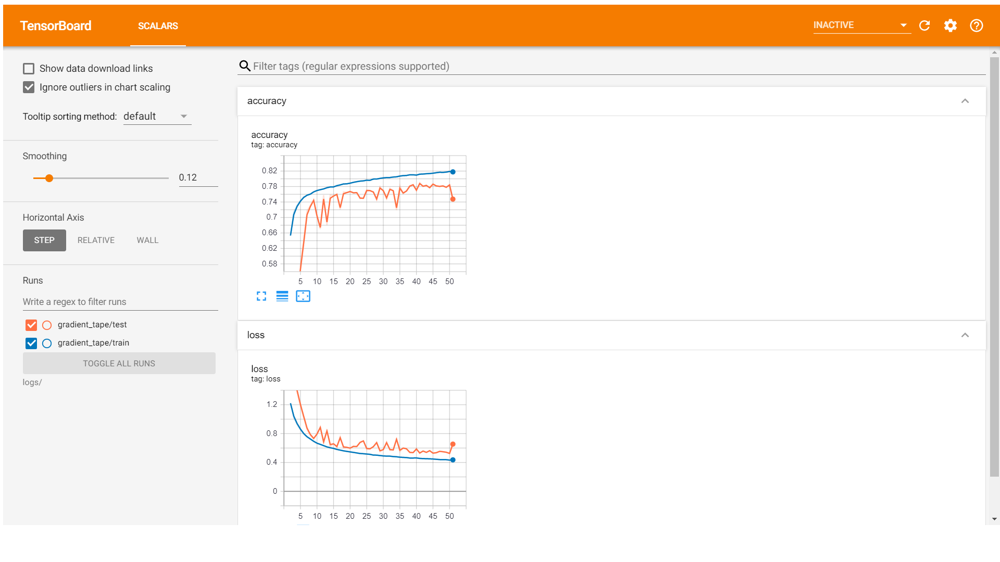

In [ ]:
from IPython.core.display import Image, display
display(Image('pspnet_scalar_50.png'))

### Prediction of a sample image using the best model from the 50 epochs 

In [ ]:
# Loading the weights of the best model
model.load_weights('pspnet_weights-epoch-40.hdf5')

In [ ]:
def predict(model,image_path):
    """
    This function will take the model which is going to be used to predict the image and the image path of 
    the input image as inputs and predict the mask
    It returns the true mask and predicted mask
    """
    # Getting the datapoint
    # This function will load the image and its annotation (mask) and return a dictionary.
    datapoint = parse_image(image_path)
    # Normalizing the resizing the datapoint
    input_image,image_mask = load_image_test(datapoint)
    # As the model takes input with 4 dimensions (batch_size, rows, columns, channels),
    # and the shape of the input image is (rows, columns, channels)
    # we will expand the first dimension so we will get the shape as  (1, rows, columns, channels)
    img = tf.expand_dims(input_image, 0)
    # Predicting the image by passing it to the model
    prediction = model(img)
    # The model will predict 8 outputs for each pixel
    # We have to get the maximum value out of it
    prediction = tf.argmax(prediction, axis=-1)
    prediction = tf.squeeze(prediction, axis = 0)
    pred_mask = tf.expand_dims(prediction, axis=-1)
    # Displaying the input image, true mask, predicted mask
    #display_sample([input_image, image_mask, pred_mask])
    return image_mask, pred_mask

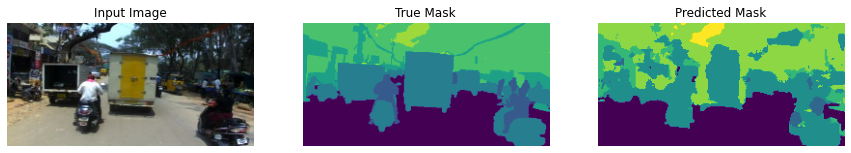

In [ ]:
# Calling the predict function
true_mask, pred_mask = predict(model,'drive/My Drive/AppliedAICaseStudies/SemanticSegmentation/idd20k_lite/leftImg8bit/val/21/240284_image.jpg')

In [ ]:
# Reference -> https://github.com/saisandeepNSS/IDD_SemanticSegmentation

def IoU(y_i,y_pred):
    # This function calculates the mean Intersection over Union
    # Mean IoU = TP/(FN + TP + FP)
    # This list will save the IoU of all the classes
    IoUs = []
    # Defining the number of classes which the model has predicted
    n_classes = 8
    for c in range(n_classes):
        # Calculating the True Positives
        TP = np.sum((y_i == c)&(y_pred==c))
        # Calculating the False Positives
        FP = np.sum((y_i != c)&(y_pred==c))
        # Calculating the False Negatives
        FN = np.sum((y_i == c)&(y_pred!= c))
        # Calculating the IoU for the particular class
        IoU = TP/float(TP + FP + FN)
        # Printing the outputs
        # Uncomment the print statement below when you want to analyze the results for each class
        #print("class {:02.0f}: #TP={:6.0f}, #FP={:6.0f}, #FN={:5.0f}, IoU={:4.3f}".format(c,TP,FP,FN,IoU))
        # Appending the IoU to the list as it mean needs to be calculated later
        if(math.isnan(IoU)):
            IoUs.append(0)
            continue
        IoUs.append(IoU)
    # Calculating the mean
    mIoU = np.mean(IoUs)
    #print("_________________")
    #print("Mean IoU: {:4.3f}".format(mIoU))
    return mIoU

In [ ]:
# Caclulating the IoU for sample predicted image
IoU(true_mask, pred_mask)

class 00: #TP=  8928, #FP=   325, #FN=  400, IoU=0.925
class 01: #TP=     0, #FP=     3, #FN=   10, IoU=0.000
class 02: #TP=   287, #FP=   231, #FN= 1078, IoU=0.180
class 03: #TP=  5801, #FP=  4705, #FN= 2050, IoU=0.462
class 04: #TP=   953, #FP=  1193, #FN= 1497, IoU=0.262
class 05: #TP=  7314, #FP=  2531, #FN= 1841, IoU=0.626
class 06: #TP=   470, #FP=    27, #FN=   45, IoU=0.867
class 07: #TP=     0, #FP=     0, #FN=    2, IoU=0.000
_________________
Mean IoU: 0.415


0.41517024313014234

## Training for 25 more epochs to see if we can get better results 

In [ ]:
# Training the model for 25 epochs

for epoch in range(25):

    print("Epoch ",epoch+1)
    
    # Getting the current time before starting the training
    # This will help to keep track of how much time an epoch took
    start = time.time()
    
    train_and_checkpoint(model, manager, dataset, epoch+1)
    
    # Saving the train loss and train accuracy metric for TensorBoard visualization
    with train_summary_writer.as_default():
        tf.summary.scalar('loss', train_loss.result(), step=ckpt.step.numpy())
        tf.summary.scalar('accuracy', train_accuracy.result(), step=ckpt.step.numpy())
    
    # Validation phase
    for (x_test, y_test) in dataset['val'].take(math.ceil(204/16)):
        pred = test_step(model, x_test, y_test)
    
    # Saving the validation loss and validation accuracy metric for Tensorboard visualization
    with test_summary_writer.as_default():
        tf.summary.scalar('loss', test_loss.result(), step=ckpt.step.numpy())
        tf.summary.scalar('accuracy', test_accuracy.result(), step=ckpt.step.numpy())
    
    # Calculating the time it took for the entire epoch to run
    print("Time taken ",time.time()-start)
    
    # Printing the metrics for the epoch
    template = 'Epoch {}, Loss: {:.3f}, Accuracy: {:.3f}, Val Loss: {:.3f}, Val Accuracy: {:.3f}'
    print (template.format(epoch+1,
                            train_loss.result(), 
                            train_accuracy.result()*100,
                            test_loss.result(), 
                            test_accuracy.result()*100))
    
    # If accuracy has increased in this epoch, updating the highest accuracy and saving the model
    if(test_accuracy.result().numpy()*100>highest_accuracy):
        print("Validation accuracy increased from {:.3f} to {:.3f}. Saving model weights.".format(highest_accuracy,test_accuracy.result().numpy()*100))
        highest_accuracy = test_accuracy.result().numpy()*100
        model.save_weights('pspnet_weights-epoch-{}.hdf5'.format(epoch+1))

    print('_'*80)

    # Reset metrics after every epoch
    train_loss.reset_states()
    test_loss.reset_states()
    train_accuracy.reset_states()
    test_accuracy.reset_states()

Epoch  1
Restored from tf_ckpts/ckpt-50
Saved checkpoint for epoch 1: tf_ckpts/ckpt-51
Time taken  49.45144867897034
Epoch 1, Loss: 0.434, Accuracy: 81.863, Val Loss: 0.574, Val Accuracy: 76.512
________________________________________________________________________________
Epoch  2
Restored from tf_ckpts/ckpt-51
Saved checkpoint for epoch 2: tf_ckpts/ckpt-52
Time taken  49.39275288581848
Epoch 2, Loss: 0.429, Accuracy: 82.010, Val Loss: 0.560, Val Accuracy: 76.981
________________________________________________________________________________
Epoch  3
Restored from tf_ckpts/ckpt-52
Saved checkpoint for epoch 3: tf_ckpts/ckpt-53
Time taken  49.43892979621887
Epoch 3, Loss: 0.429, Accuracy: 81.980, Val Loss: 0.532, Val Accuracy: 78.595
________________________________________________________________________________
Epoch  4
Restored from tf_ckpts/ckpt-53
Saved checkpoint for epoch 4: tf_ckpts/ckpt-54
Time taken  49.17596507072449
Epoch 4, Loss: 0.420, Accuracy: 82.327, Val Loss: 0.540

In [ ]:
%tensorboard --logdir logs/

Reusing TensorBoard on port 6006 (pid 51274), started 0:34:10 ago. (Use '!kill 51274' to kill it.)

<IPython.core.display.Javascript object>

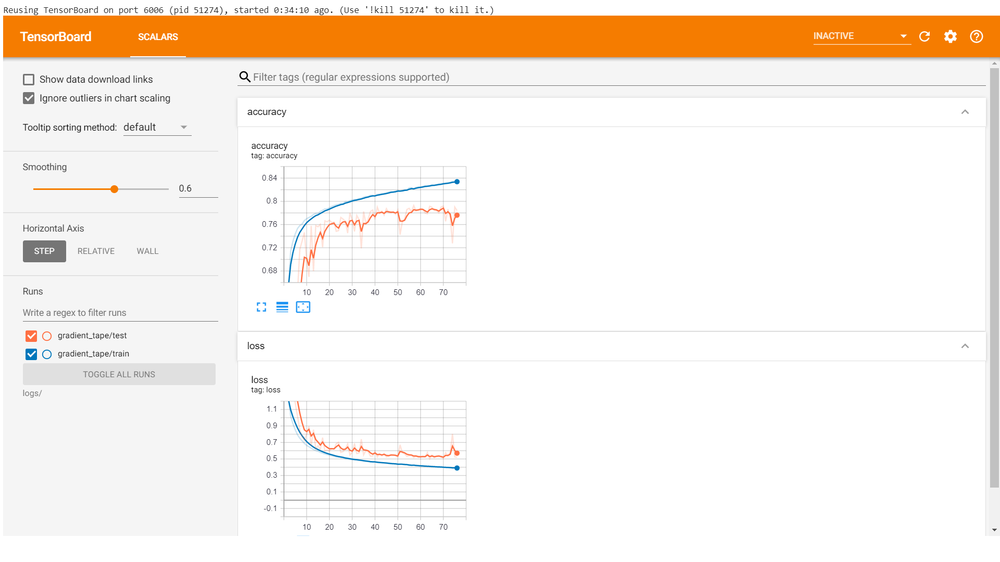

In [ ]:
display(Image('pspnet_scalar_75.png'))

In [ ]:
# Highest Accuracy for PSPNet model
highest_accuracy

79.26446199417114

### Prediction of a sample image using the best model from all the 75 epochs 

In [ ]:
# Loading the weights of the best model
model.load_weights('pspnet_weights-epoch-6.hdf5')

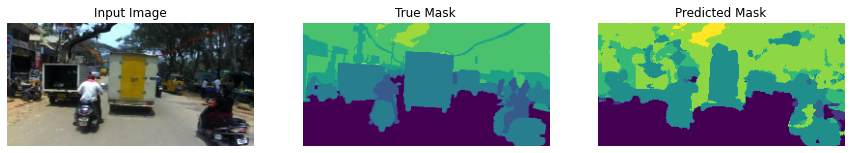

In [ ]:
# Calling the predict function
true_mask, pred_mask = predict(model,'drive/My Drive/AppliedAICaseStudies/SemanticSegmentation/idd20k_lite/leftImg8bit/val/21/240284_image.jpg')

In [ ]:
# Getting the IoU for the sample predicted image
IoU(true_mask, pred_mask)

class 00: #TP=  8772, #FP=   261, #FN=  556, IoU=0.915
class 01: #TP=     0, #FP=   313, #FN=   10, IoU=0.000
class 02: #TP=   176, #FP=    33, #FN= 1189, IoU=0.126
class 03: #TP=  5407, #FP=  3350, #FN= 2444, IoU=0.483
class 04: #TP=  1005, #FP=  1580, #FN= 1445, IoU=0.249
class 05: #TP=  7695, #FP=  3624, #FN= 1460, IoU=0.602
class 06: #TP=   489, #FP=    63, #FN=   26, IoU=0.846
class 07: #TP=     0, #FP=     0, #FN=    2, IoU=0.000
_________________
Mean IoU: 0.403


0.40262216309202514

### The mIoU has decreased from 0.415 to 0.402 

### Let's check the validation mIoU for the second best model

In [ ]:
# Getting the validation image paths
img_val = dataset_path + 'leftImg8bit/val/'
val_paths = glob(img_val+'*/*_image.jpg')

In [ ]:
# Getting the mIou for all the validation image predictions and storing it in a list
mIoU = []
for path in val_paths:
    true_mask, pred_mask = predict(model,path)
    mIoU.append(IoU(true_mask, pred_mask))

In [ ]:
# Calculating the avergae validation mIoU for all the validation images predicted using PSPNet
print("Validation mIoU = ",sum(mIoU)/len(mIoU))

Validation mIoU =  0.40476463770217896


### Now let's load the model with high mIoU to see if validation mIoU increases 

In [ ]:
# Loading the weights of the best model
model.load_weights('pspnet_weights-epoch-40.hdf5')

In [ ]:
# Getting the mIoU for all the validation image predictions and storing it in a list
mIoU = []
for path in val_paths:
    true_mask, pred_mask = predict(model,path)
    mIoU.append(IoU(true_mask, pred_mask))

In [ ]:
# Calculating the avergae validation mIoU for all the validation images predicted using PSPNet
print("Validation mIoU = ",sum(mIoU)/len(mIoU))

Validation mIoU =  0.40613095345863826


## Observations

<b> The highest average mIoU of all the validation images is <i>0.406</i> </b>

## Prediction of Test Images for PSPNet

In [ ]:
# Getting the test_image_paths
img_test = dataset_path + 'leftImg8bit/test/'
test_paths = glob(img_test+'*/*_image.jpg')

In [ ]:
# Reference -> https://github.com/mohanrajmit/IDD/blob/master/seg_updated.ipynb
test_images_final = []
test_images_name = []

for imagePath in test_paths:
    # Reading the image from the image_path
    image=cv2.imread(imagePath)
    # Suppose the imagePath is = ../idd20k_lite/leftImg8bit/test/8/561264_image.jpg
    # We need the '561264_image.jpg' part
    # So, we split the imagePath on '/' and get the last element
    # So, make = 561264_image.jpg
    make = imagePath.split("/")[-1]
    # We need the filename now
    # filename = 561264 i.e. all the characters before '_'
    filename = make[:make.rfind("_")]
    # Now, we need the directory name in which we have to store the predicted image
    # i.e. the second last element of '../idd20k_lite/leftImg8bit/test/8/561264_image.jpg'
    # after splitting it on the basis of '/'
    # So make_new = 8
    make_new = imagePath.split("/")[-2]  
    # We will define the directory as "output/8"
    directory="output/"+ make_new
    # If the directory does not exist, we will make the directory
    if not os.path.exists(directory):
        os.makedirs(directory)
    # Output image will be stored in the path 'output/8/561264_label.png' 
    # with '_label' attached to the filename
    image_name = "output/"+ make_new+"/"+filename+"_label.png"
    # Storing the image array in test_images_final
    test_images_final.append(image)
    # Storing the image_name in test_images_name
    test_images_name.append(image_name)

In [ ]:
test_images_final = np.array(test_images_final)

In [ ]:
# Printing the shape of test_images_final
test_images_final.shape

(404, 227, 320, 3)

In [ ]:
for i,image in enumerate(test_images_final):
    # scaling the values to [0,1]
    image = tf.image.convert_image_dtype(image, tf.uint8)
    # resizing the image to (128,256)
    image = tf.image.resize(image, (HEIGHT,WIDTH))
    # As the model takes input with 4 dimensions (batch_size, rows, columns, channels),
    # and the shape of the input image is (rows, columns, channels)
    # we will expand the first dimension so we will get the shape as  (1, rows, columns, channels)
    image = tf.expand_dims(image, 0)
    # Predicting the image
    prediction = model(image)
    # The model will predict 8 outputs for each pixel
    # We have to get the maximum value out of it
    prediction = tf.argmax(prediction, axis=-1)
    # Squeeze removes dimensions of size 1 from the shape of a tensor.
    prediction = tf.squeeze(prediction, axis = 0)
    prediction = tf.expand_dims(prediction, axis=-1)
    # Converting the prediction to an array
    prediction = np.array(prediction)
    # All the pixels that are predicted as 7 belong to the class 255
    prediction[prediction == 7] = 255
    # Stroing the image in the disk using the corresponing image_path and 
    # name stored in test_images_name list
    cv2.imwrite(test_images_name[i],prediction)

In [ ]:
!zip -r output_pspnet.zip output

  adding: output/ (stored 0%)
  adding: output/445/ (stored 0%)
  adding: output/445/frame0297_label.png (deflated 4%)
  adding: output/259/ (stored 0%)
  adding: output/259/frame0014_label.png (deflated 4%)
  adding: output/19/ (stored 0%)
  adding: output/19/090189_label.png (deflated 6%)
  adding: output/19/439348_label.png (deflated 3%)
  adding: output/19/762865_label.png (deflated 3%)
  adding: output/19/523513_label.png (deflated 3%)
  adding: output/19/171279_label.png (deflated 2%)
  adding: output/19/894649_label.png (deflated 3%)
  adding: output/566/ (stored 0%)
  adding: output/566/frame0749_label.png (deflated 2%)
  adding: output/566/frame2399_label.png (deflated 1%)
  adding: output/54/ (stored 0%)
  adding: output/54/383874_label.png (deflated 3%)
  adding: output/281/ (stored 0%)
  adding: output/281/frame2194_label.png (deflated 2%)
  adding: output/281/frame1396_label.png (deflated 2%)
  adding: output/408/ (stored 0%)
  adding: output/408/0002221_label.png (deflate

## Observations 

In [ ]:
from prettytable import PrettyTable

# Representing results in a table
pt = PrettyTable()

pt.field_names = ["Model", "Highest Accuracy", "Validation mIoU"]
pt.add_row(["UNet",82.30696,0.44561])
pt.add_row(["PSPNet",79.26446, 0.40613])
print(pt)            

+--------+------------------+-----------------+
| Model  | Highest Accuracy | Validation mIoU |
+--------+------------------+-----------------+
|  UNet  |     82.30696     |     0.44561     |
| PSPNet |     79.26446     |     0.40613     |
+--------+------------------+-----------------+


We can observe that UNet performs better on this dataset.  

## Conclusion

- Two different models (UNet and PSPNet) were implemented.
- Both these models have performed well in the past for Semantic Segmentation Challenges.
- For this dataset, UNet gives a validation mIoU of 0.44561 while PSPNet gives a validation mIoU of 0.40613.

## References 

- https://arxiv.org/pdf/1612.01105.pdf
- https://arxiv.org/pdf/1505.04597.pdf
- https://github.com/saisandeepNSS/IDD_SemanticSegmentation
- https://yann-leguilly.gitlab.io/post/2019-12-14-tensorflow-tfdata-segmentation/
- https://medium.com/analytics-vidhya/semantic-segmentation-in-pspnet-with-implementation-in-keras-4843d05fc025
- https://github.com/junhoning/machine_learning_tutorial/
